## Agrupamento dos eventos

Este caderno lê a base de arestas (`data/arestas/0_arestas_completo.csv`) que contem dados dos congestionamentos e acidentes.

Aqui, experimentamos 3 estratégias de agrupamentos e avaliamos seu desempenho (corretude e eficiencia computacional)
- DBCSCAN
- Hierárquico
- K-Médias

O resultado final desse processamento é o arquivo `data/eventos/eventos_completo.csv` com o resultado do agrupamento de melhor performance


In [1]:
import pandas as pd
from datetime import datetime, timedelta

from scipy.spatial.distance import euclidean
import hdbscan

from shapely import wkt
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering

import matplotlib.pyplot as plt
import numpy as np

import aux.sao_paulo_shapefile as sp_shp
import aux.sao_paulo_graph as sp_graph
import aux.agrupamento as agrup
import aux.arestas as arestas
from importlib import reload
reload(agrup)
reload(arestas)

<module 'aux.arestas' from 'c:\\Users\\gigec\\OneDrive\\Documentos\\Pedro\\MBA\\TCC\\src\\aux\\arestas.py'>

In [2]:
df = arestas.le_e_processa_arestas('data/arestas/0_arestas_completo.csv') # 5007436 # 4986036 

c:\Users\gigec\OneDrive\Documentos\Pedro\MBA\TCC\src\aux\arestas.py:10: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(path)


23:22:56	Transformando campos de data em numérico (1 min)
23:23:14	Fim da transformacao
23:23:14	Extraindo LineStrings (2 min)
23:24:38	Obtendo ponto médio (1 min)
23:25:27	Separando coordenadas (3 min)
23:28:34	Eliminando duplicidades
			 21400 registros duplicados deletados
			 4986036 registros restantes
23:28:37	Fim Processamento


## Testando diferentes agrupamentos

In [4]:
#inicio = datetime(2019, 4, 12, 0, 0, 0)
#inicio = datetime(2019, 7, 24, 0, 0, 0)
inicio = datetime(2019, 8, 30, 0, 0, 0)
fim = inicio + timedelta(hours=24)

df_dia = df[(df['datetime'] >= inicio) & (df['datetime'] <= fim)]
print(f'Quantidade de Arestas: {len(df_dia)}')

arestas.plota_arestas(df_dia)

features = df_dia[['lat', 'lon', 'time_scaled']].values

Quantidade de Arestas: 4772


In [19]:
# dbscan
clusters = DBSCAN(eps=.0055, min_samples = 2, metric = 'euclidean').fit(features)
agrup.avalia_clusters(df_dia, features, clusters)

Silhueta:  -0.16505136304103804
DBCV:  0.42591193000980343


In [11]:
# tentativa 4: agrupamento hierárquico

clusters = AgglomerativeClustering(n_clusters=None, distance_threshold=0.04, linkage='average').fit(features)
agrup.avalia_clusters(df_dia, features, clusters)

Silhueta:  0.36044218024753605
DBCV:  -0.39838211119004124


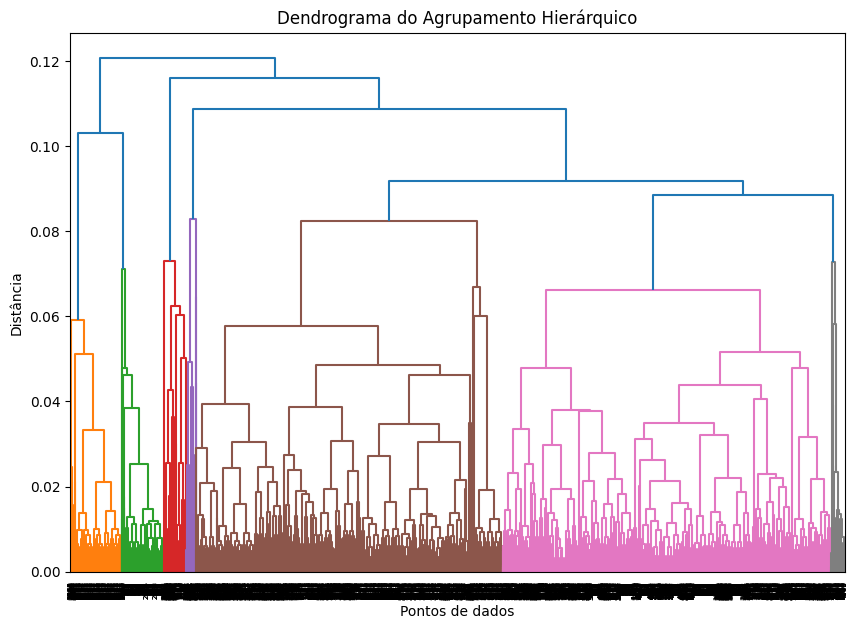

In [12]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
import numpy as np

# Calcula a matriz de ligação usando o método 'ward' (ou outro, se preferir)
Z = linkage(features, method='average')

# Plota o dendrograma
plt.figure(figsize=(10, 7))
dendrogram(Z)
plt.title("Dendrograma do Agrupamento Hierárquico")
plt.xlabel("Pontos de dados")
plt.ylabel("Distância")
plt.show()

In [13]:
# k-médias

n_congestionamentos = len(df_dia[df_dia['index'].str.startswith('c')]['index'].unique())
n_clusters = round(n_congestionamentos * 0.5)

clusters = KMeans(n_clusters=n_clusters, random_state=42).fit(features)
agrup.avalia_clusters(df_dia, features, clusters)

Silhueta:  0.3903419311535268
DBCV:  -0.24387289602206608


In [159]:

# Lista para armazenar os scores
silhouette_scores = []
dbcv_scores = []
cluster_range = range(1000, 1050, 10)  # Testar de 2 a 10 clusters

# Calcula o Silhouette Score para cada número de clusters
for n_clusters in cluster_range:
    print(f'{datetime.now().strftime("%H:%M:%S")}\t {n_clusters}/{max(cluster_range)}')
    kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(features)
    labels = agrup.separa_cluster_ruido(kmeans.labels_)
    dbcv_scores.append(hdbscan.validity_index(features, labels, mst_raw_dist = True))
    silhouette_avg = silhouette_score(features, labels)
    silhouette_scores.append(silhouette_avg)


21:29:33	 1000/1040
21:30:38	 1010/1040
21:32:10	 1020/1040
21:33:12	 1030/1040
21:34:17	 1040/1040


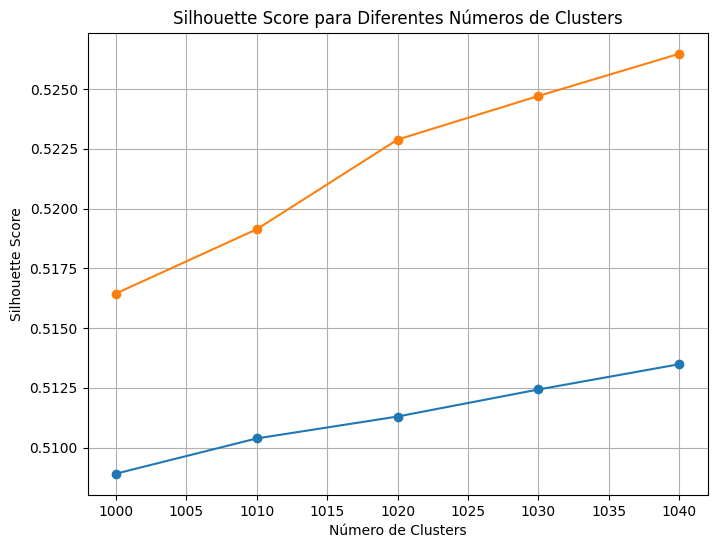

In [161]:

# Plotando o Silhouette Score para cada número de clusters
plt.figure(figsize=(8, 6))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.plot(cluster_range, dbcv_scores, marker='o')
plt.title("Silhouette Score para Diferentes Números de Clusters")
plt.xlabel("Número de Clusters")
plt.ylabel("Silhouette Score")
plt.grid(True)
plt.show()

### Processamento por dias

In [28]:
def process_clusters(algorithm_name, clusters, features, results_list, inicio):
    labels = agrup.separa_cluster_ruido(clusters.labels_)
    unique_labels = np.unique(labels)
    
    # Cálculo do silhouette score
    if len(unique_labels) == 1 or len(unique_labels) == len(features):
        s = 0  # Se todos os pontos estão em um único cluster ou cada ponto é um cluster, não há como calcular o silhouette score
    else:
        s = silhouette_score(features, labels)
    
    # Cálculo do índice de validade
    validity = hdbscan.validity_index(features, labels, mst_raw_dist=True)

    results_list.append((inicio, s, validity))

def processa_comparacao_clusters(inicio, termina_em):

    # Listas para armazenar os resultados
    results_dbscan = []
    results_hierarquico = []
    results_k_means = []

    while inicio <= termina_em:
        print('*******************************************')
        print(f'{datetime.now().strftime("%H:%M:%S")}\tProcessando dia {inicio}')
        
        fim = inicio + timedelta(days=1)
        df_dia = df[(df['datetime'] >= inicio) & (df['datetime'] <= fim)]
        features = df_dia[['lat', 'lon', 'time_scaled']].values
        
        # DBSCAN
        print(f'{datetime.now().strftime("%H:%M:%S")}\tExecutando DBSCAN')
        clusters_dbscan = DBSCAN(eps=.0055, min_samples=2, metric='euclidean').fit(features)
        process_clusters('dbscan', clusters_dbscan, features, results_dbscan, inicio)
        
        # Clustering Hierárquico
        print(f'{datetime.now().strftime("%H:%M:%S")}\tExecutando Hierárquico')
        clusters_hierarquico = AgglomerativeClustering(n_clusters=None, distance_threshold=0.005, linkage='single').fit(features)
        process_clusters('hierarquico', clusters_hierarquico, features, results_hierarquico, inicio)
        
        # K-means
        print(f'{datetime.now().strftime("%H:%M:%S")}\tExecutando K-means')
        n = len(df_dia[df_dia['index'].str.startswith('c')]['index'].unique())
        if n == 0: 
            n = len(df_dia)
        clusters_k_means = KMeans(n_clusters=n, random_state=42).fit(features)
        process_clusters('k-means', clusters_k_means, features, results_k_means, inicio)
        
        # Avançar para o próximo dia
        inicio = fim

    return results_dbscan, results_hierarquico, results_k_means

#results_dbscan, results_hierarquico, results_k_means = processa_comparacao_clusters(datetime(2019, 1, 1), datetime(2019, 12, 31))

In [29]:
def visualizar_resultados(results_dbscan, results_hierarquico, results_k_means, dia_semana = None):
    # Transformar resultados em DataFrames para facilitar a manipulação
    df_dbscan = pd.DataFrame(results_dbscan, columns=['Data', 'Silhouette', 'Validity'])
    df_hierarquico = pd.DataFrame(results_hierarquico, columns=['Data', 'Silhouette', 'Validity'])
    df_kmeans = pd.DataFrame(results_k_means, columns=['Data', 'Silhouette', 'Validity'])

    if dia_semana != None:
        df_dbscan['dia_semana'] = df_dbscan['Data'].dt.weekday
        df_hierarquico['dia_semana'] = df_hierarquico['Data'].dt.weekday
        df_kmeans['dia_semana'] = df_kmeans['Data'].dt.weekday

        df_dbscan = df_dbscan.loc[df_dbscan['dia_semana'] == dia_semana]
        df_hierarquico = df_hierarquico.loc[df_hierarquico['dia_semana'] == dia_semana]
        df_kmeans = df_kmeans.loc[df_kmeans['dia_semana'] == dia_semana]
        
        df_dbscan = df_dbscan[df_dbscan['Data'] != '2019-01-25']
        df_dbscan = df_dbscan[df_dbscan['Data'] != '2019-03-29']
        df_dbscan = df_dbscan[df_dbscan['Data'] != '2019-04-19']
        df_hierarquico = df_hierarquico[df_hierarquico['Data'] != '2019-01-25']
        df_hierarquico = df_hierarquico[df_hierarquico['Data'] != '2019-03-29']
        df_hierarquico = df_hierarquico[df_hierarquico['Data'] != '2019-04-19']
        df_kmeans = df_kmeans[df_kmeans['Data'] != '2019-01-25']
        df_kmeans = df_kmeans[df_kmeans['Data'] != '2019-03-29']
        df_kmeans = df_kmeans[df_kmeans['Data'] != '2019-04-19']
    
    # Configurar o tamanho dos gráficos
    plt.figure(figsize=(14, 10))

    # Gráfico de Silhouette Score
    plt.subplot(2, 1, 1)
    plt.plot(df_dbscan['Data'], df_dbscan['Silhouette'], label='DBSCAN', marker='o', color='b')
    plt.plot(df_hierarquico['Data'], df_hierarquico['Silhouette'], label='Hierárquico', marker='x', color='y')
    plt.plot(df_kmeans['Data'], df_kmeans['Silhouette'], label='K-means', marker='s', color='r')
    plt.title('Coeficiente de Silhueta dos Métodos de Agrupamento')
    plt.xlabel('Data')
    plt.ylabel('Silhouette Score')
    plt.xticks(rotation=45)
    plt.legend(loc='upper right')

    # Gráfico de Validity Index
    plt.subplot(2, 1, 2)
    plt.plot(df_dbscan['Data'], df_dbscan['Validity'], label='DBSCAN', marker='o', color='b')
    plt.plot(df_hierarquico['Data'], df_hierarquico['Validity'], label='Hierárquico', marker='x', color='y')
    plt.plot(df_kmeans['Data'], df_kmeans['Validity'], label='K-means', marker='s', color='r')
    plt.title('DBCV dos Métodos de Agrupamento')
    plt.xlabel('Data')
    plt.ylabel('Validity Index')
    plt.xticks(rotation=45)
    plt.legend(loc='upper right')

    # Ajustar layout
    plt.tight_layout()
    
    # Mostrar gráficos
    plt.savefig('data/comparacao_sexta_agrupamento_outro.png')
    plt.show()

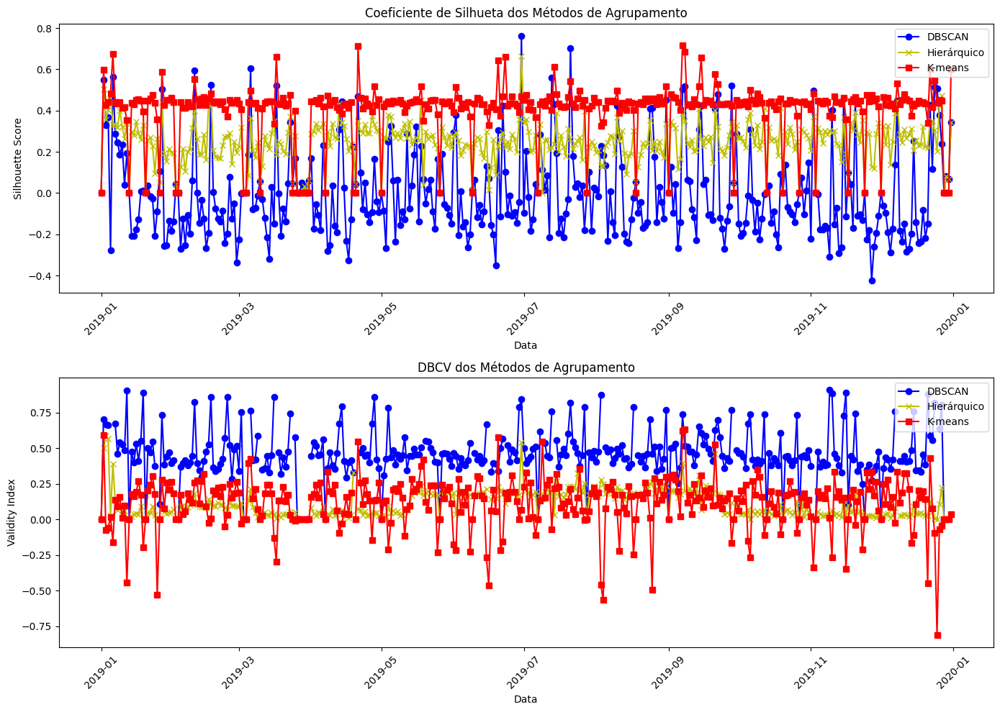

In [298]:
visualizar_resultados(results_dbscan, results_hierarquico, results_k_means)

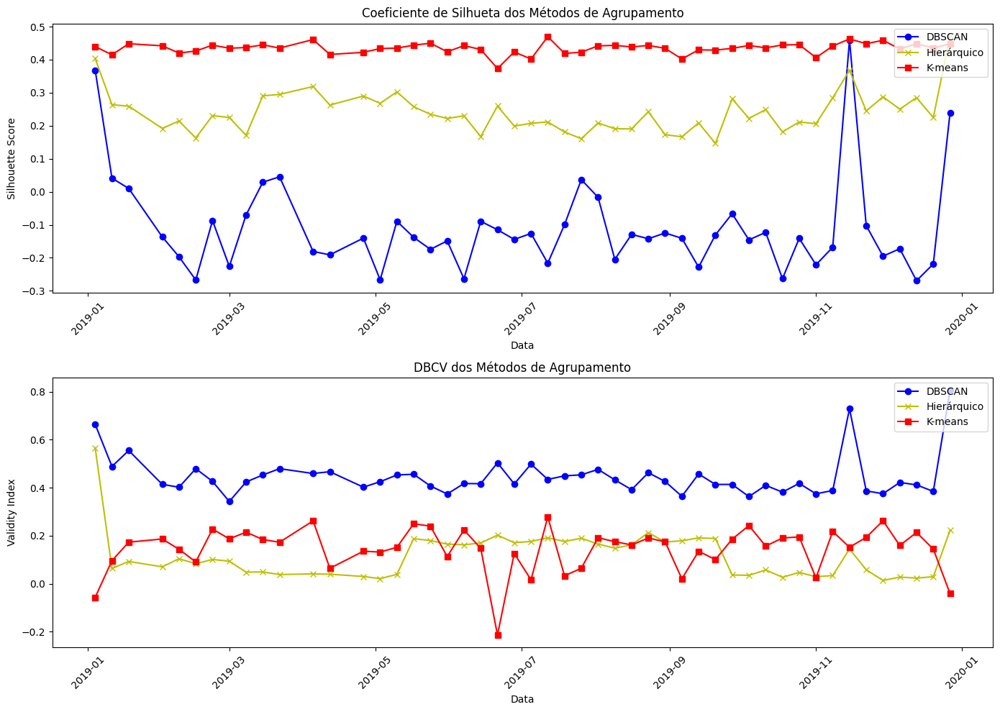

In [300]:
visualizar_resultados(results_dbscan, results_hierarquico, results_k_means, dia_semana = 4)

#### Processamento geral dos eventos

In [14]:
print('{}\t Fazendo leitura do arquivo (2 min)'.format(datetime.now().strftime('%H:%M:%S')))
gdf = sp_shp.read_and_process_file('data/logradouros/SIRGAS_SHP_logradouronbl_line.shp')

print('{}\t Iniciando criação do grafo (2 min)'.format(datetime.now().strftime('%H:%M:%S')))
G = sp_graph.create_and_process_graph (gdf)

print('{}\t Fim da criação do grafo'.format(datetime.now().strftime('%H:%M:%S')))

23:39:18	 Fazendo leitura do arquivo (2 min)
23:39:30	 Iniciando criação do grafo (2 min)
23:40:12	 Fim da criação do grafo


In [32]:
df_cluster = df_dia.loc[df_dia['cluster'] == 5]
print(agrup.obtem_evento(G, df_cluster))

arestas.plota_arestas(df_cluster)

#hora = 22
#arestas.plota_arestas(df_cluster.loc[(df_cluster['datetime'] >= datetime(2019, 8, 30, hora, 0, 0)) & 
#                                   (df_cluster['datetime'] < datetime(2019, 8, 30, hora + 1, 0, 0))])

(Timestamp('2019-08-30 09:00:00'), Timestamp('2019-08-30 13:30:00'), Timedelta('0 days 04:30:00'), np.int32(4), datetime.time(9, 0), 1400.0, 53, 3.7358490566037736, 1, 0, np.float64(0.0), datetime.time(10, 52))


In [23]:
def processa_eventos(G, df, ano, mes):
    eventos = []
    inicio = datetime(ano, mes, 1)
    while inicio.month == mes:
        fim = inicio + timedelta(days = 1)

        df_dia = df[(df['datetime'] >= inicio) & (df['datetime'] <= fim)]
        features = df_dia[['lat', 'lon', 'time_scaled']].values
    
        clusters = DBSCAN(eps=.0055, min_samples=2, metric='euclidean').fit(features)
        labels = agrup.separa_cluster_ruido(clusters.labels_)

        df_dia['clusters'] = labels
        df.loc[df_dia.index, 'clusters'] = df_dia['clusters']
        unique_labels = np.unique(labels)

        for c in unique_labels:
            evento = agrup.obtem_evento(G, df_dia.loc[df_dia['clusters'] == c])
            eventos.append((c, *evento))

        inicio = fim

    df = pd.DataFrame(eventos, columns = ['cluster', 'momento_inicial', 'momento_final', 'duracao',
            'dia_semana', 'hora_inicial', 'tamanho',
            'n_vertices', 'media_grau',
            'n_acidentes', 'tipo_acidente', 'qtde_vitimas', 'hora_acidente'])
    df.to_csv(f'data/eventos/eventos_{ano}_{mes}.csv')


In [24]:
print(f'{datetime.now().strftime("%H:%M:%S")}\t Inicio do processamento da clusterização (10 min)')
for ano in range(2019, 2024):
    print(f'{datetime.now().strftime("%H:%M:%S")}\t Ano {ano} (2 min)')
    for mes in range(1, 13):
        processa_eventos(G, df, ano, mes)

23:42:25	 Inicio do processamento da clusterização (10 min)
23:42:25	 Ano 2019 (2 min)
23:44:13	 Ano 2020 (2 min)
23:45:47	 Ano 2021 (2 min)
23:47:20	 Ano 2022 (2 min)
23:48:48	 Ano 2023 (2 min)


In [25]:
dfs = []
for ano in range(2019, 2024):
    for mes in range(1, 13):
        d = pd.read_csv(f'data/eventos/eventos_{ano}_{mes}.csv')
        dfs.append(d)

df_eventos = pd.concat(dfs)
df_eventos.to_csv('data/eventos/eventos_completo.csv')